# Spatial clustering of CODEX spatial proteomics data
This tutorial shows an example of spatial clustering of a CODEX dataset of mouse spleens from [Goltsev et al., 2018](https://doi.org/10.1016/j.cell.2018.07.010) using CellCharter.
The dataset is composed of 3 healthy samples (BALBc-1 to BALBc-3) and 6 samples from mice with the systmeic lupus erythematosus disease (MRL-4 to MRL-9) for a total of more than 700k cells assyed for around 30 protein markers. <br>
We are going to use trVAE for dimensionality reduction and CellCharter to compute the spatial clusters of all samples together.

IMPORTANT: to decrease the amount of time required to run the notebook, we are running the analysis on the same dataset but with parameters different from the original publication. Hence, the results may slightly differ from the ones reported in the paper. 

Let's first load the packages that will be necessary for the analysis.

In [1]:
import squidpy as sq
import cellcharter as cc
import scanpy as sc

/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/spatialdata/__init__.py:9: UserWarning: Geopandas was set to use PyGEOS, changing to shapely 2.0 with:

	geopandas.options.use_pygeos = True

If you intended to use PyGEOS, set the option to False.
  _check_geopandas_using_shapely()
Validation errors in config file(s).
The following fields have been reset to the default value:

application -> window_maximized
  none is not an allowed value (type=type_error.none.not_allowed)
application -> window_fullscreen
  none is not an allowed value (type=type_error.none.not_allowed)

/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/torchvision/io/image.py:

## Data preprocessing

We can download the full dataset directly through CellCharter.

In [2]:
adata = cc.datasets.codex_mouse_spleen('./data/codex_mouse_spleen.h5ad')
adata

AnnData object with n_obs × n_vars = 707474 × 29
    obs: 'cell_type', 'i-niche', 'tile', 'area', 'dataset', 'stage', 'sample'
    uns: 'spatial', 'spatial_cluster_colors'
    obsm: 'blanks', 'spatial'

We are now going to scale the intensity values of each marker individually using scanpy's `pp.scale` function.

First, we save the unscaled data in the raw version of our anndata object, so that we can retrieve it any time.<br>
Then, each sample will be scaled indepenendently. However, scanpy does not implement this functionality, so we will do it manually.


In [3]:
adata.raw = adata.copy()
for sample in adata.obs['sample'].cat.categories:
    adata.X[adata.obs['sample'] == sample, :] = sc.pp.scale(adata[adata.obs['sample'] == sample], copy=True).X

## Dimensionality reduction


Given the limited number of markers in current spatial proteomics technologies, dimensionality reduction is not stricly necessary. However, we noticed that it can help in reducing noise and speed up the clustering step. This is crucial especially in the cluster stability analysis, that, to suggest the best candidates for the number of clusters, repeats the clustering multiple times.

We are going to use a trVAE model already pretrained on this dataset.<br>
First we load the model. In `map_location` you can specify the device in which you want to load the model. This allows to load, for example, to load on CPU a model trained on a GPU.
In fact, this model was trained on a GPU, but we are going to load it on the CPU.


In [4]:
model = cc.tl.TRVAE.load('./tutorial_models/codex_mouse_spleen_trvae', adata, map_location='cpu')

AnnData object with n_obs × n_vars = 707474 × 29
    obs: 'cell_type', 'i-niche', 'tile', 'area', 'dataset', 'stage', 'sample'
    uns: 'spatial', 'spatial_cluster_colors'
    obsm: 'blanks', 'spatial'

INITIALIZING NEW NETWORK..............
Encoder Architecture:
	Input Layer in, out and cond: 29 128 1
	Hidden Layer 1 in/out: 128 128
	Mean/Var Layer in/out: 128 10
Decoder Architecture:
	First Layer in, out and cond:  10 128 1
	Hidden Layer 1 in/out: 128 128
	Output Layer in/out:  128 29 



Then we are going to extract the dimensionality-reduced embeddings for all cells of the dataset. We use the `dataset` labels, which are the same for all cells of this dataset, as condition, because there was no need to correct for batch effects.


In [5]:
adata.obsm['X_trVAE'] = model.get_latent(adata.X, adata.obs['dataset'])

## CellCharter's spatial clustering
It's now time to compute the spatial clusters.<br>
CellCharter encodes all cells of each sample as a network. Every cell is a node and two cells are connected by an edge if they are physically close to each other in the tissue.
We can obtain this network using squidpy's `gr.spatial_neighbors` function.

In [6]:
sq.gr.spatial_neighbors(adata, library_key='sample', coord_type='generic', delaunay=True)

However, the Delaunay triangulation used by squidpy has the drawback of generating connections between distant cells.<br>
We can see it by zooming in one area of the BALBc-3 sample.

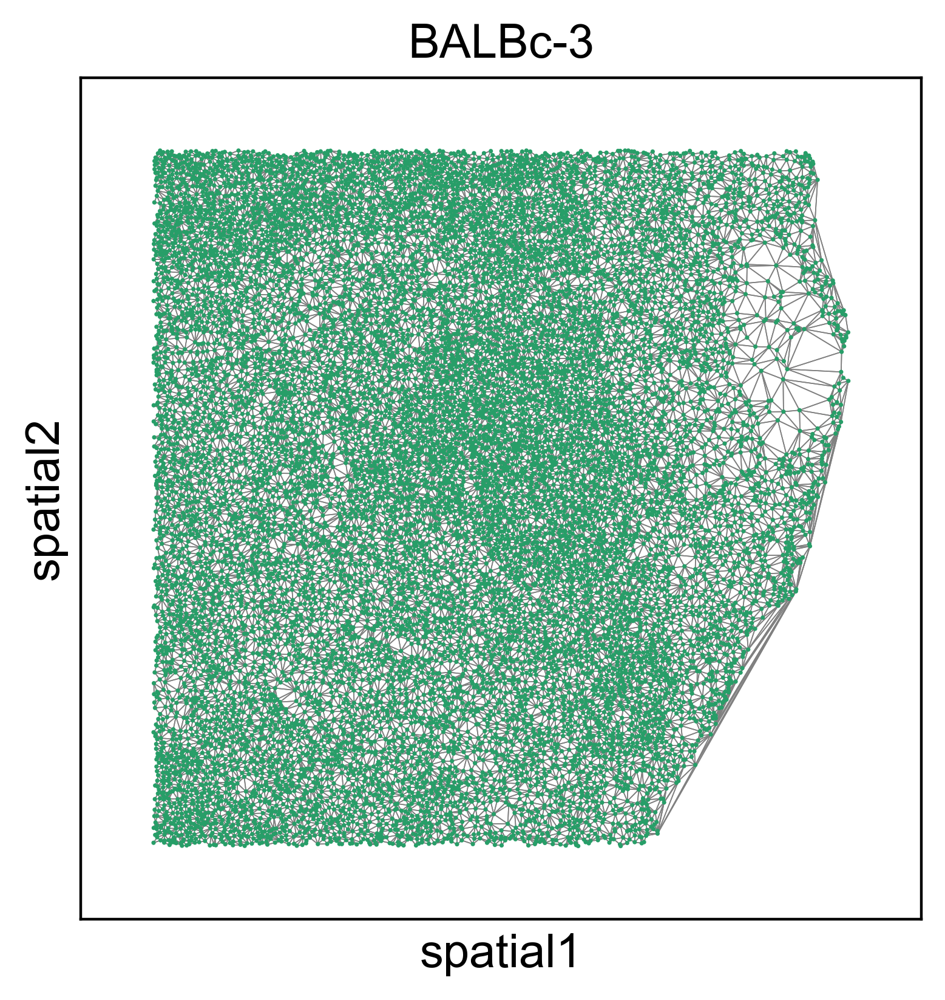

In [7]:
sq.pl.spatial_scatter(
    adata, 
    color='sample', 
    library_key='sample', 
    img=None, 
    title=['BALBc-3'],
    size=2500,
    connectivity_key='spatial_connectivities',
    edges_width=0.3,
    legend_loc=None,
    crop_coord=(900000, 900000, 1700000, 1700000 ),
    library_id=['BALBc-3']
    )

One could decide a maximum radius and pass it as a parameter to the function, but it depends from dataset to dataset based on the spatial resolution of the data. We developed a method called gr.remove_longLinks that removes links that have a distance greater than a certain percentile (the default is the 99th percentile). We can see that it greatly reduces the long links without affecting the rest.

In [8]:
cc.gr.remove_long_links(adata)

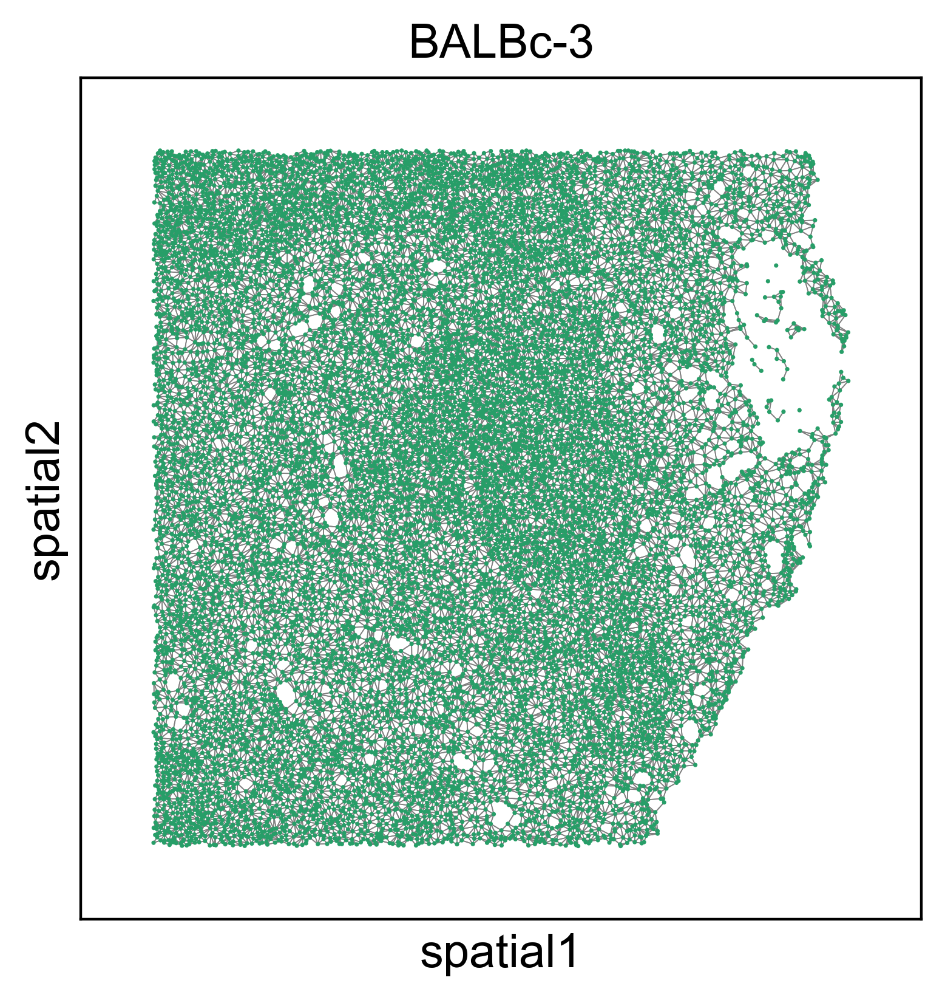

In [9]:
sq.pl.spatial_scatter(
    adata, 
    color='sample', 
    library_key='sample', 
    img=None, 
    title=['BALBc-3'],
    size=2500,
    connectivity_key='spatial_connectivities',
    edges_width=0.3,
    legend_loc=None,
    crop_coord=(900000, 900000, 1700000, 1700000 ),
    library_id=['BALBc-3']
    )

The next step is the neighborhood aggregation. It consists of concatenating the features of every cell with the features aggregated from neighbors ad increasing layers from the considered cell, up to a certain layer `n_layers`. Aggregation functions are used to obtain a single feature vector from the vectors of multiple neighbors, with the default being the `mean` function.

In this case we use 3 layers of neighbors, so we obtain, for each cell, a feature vector of length 40. That is the cell's reduced vector size from trVAE (10) plus the 3 aggregated vectors of length 10 each, from the 3 layers of neighbors.

In [10]:
cc.gr.aggregate_neighbors(adata, n_layers=3, use_rep='X_trVAE')

  0%|          | 0/9 [00:00<?, ?it/s]

We create the Gaussian Mixture model, specifying 11 as desired number of clusters. This value was obtained from the cluster stability analysis. For more details, you can check our paper.

In [11]:
gmm = cc.tl.Cluster(
    n_clusters=11, 
    random_state=12345,
    # If running on GPU
    #trainer_params=dict(accelerator='gpu', devices=1)
)

Then we fit the model to the data and predict the cluster label of all cells.

In [12]:
gmm.fit(adata, use_rep='X_cellcharter')
adata.obs['spatial_cluster'] = gmm.predict(adata, use_rep='X_cellcharter')

Training: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

We can visualize the spatial clusters for some samples. In this case, we chose a healthy sample, and samples from the early, intermediate and late stage.

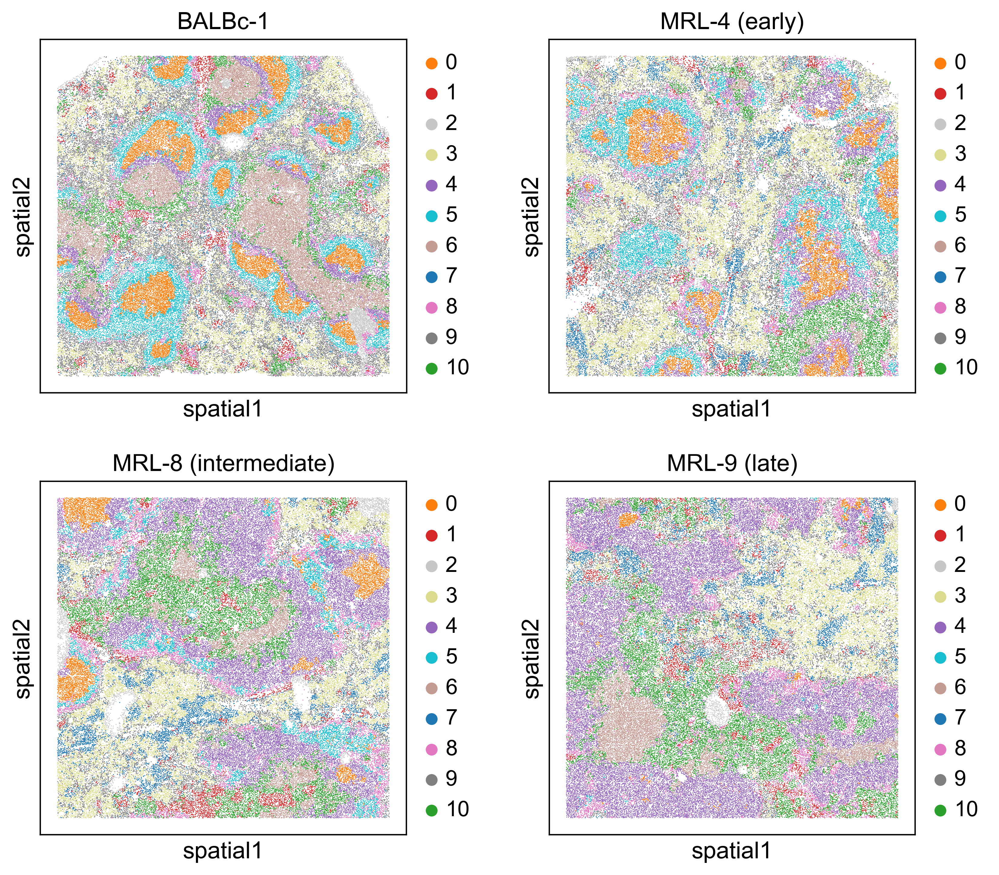

In [13]:
sq.pl.spatial_scatter(
    adata, 
    color='spatial_cluster', 
    library_key='sample', 
    img=None, 
    title=['BALBc-1', 'MRL-4 (early)', 'MRL-8 (intermediate)', 'MRL-9 (late)'],
    size=2500,
    ncols=2,
    library_id=['BALBc-1', 'MRL-4', 'MRL-8', 'MRL-9']
)

/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: divide by zero encountered in log2
  result = func(self.values, **kwargs)
/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:699: RuntimeWarning: invalid value encountered in power
  size = frac**size_exponent
/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1067: VisibleDeprecationWarning: Creat

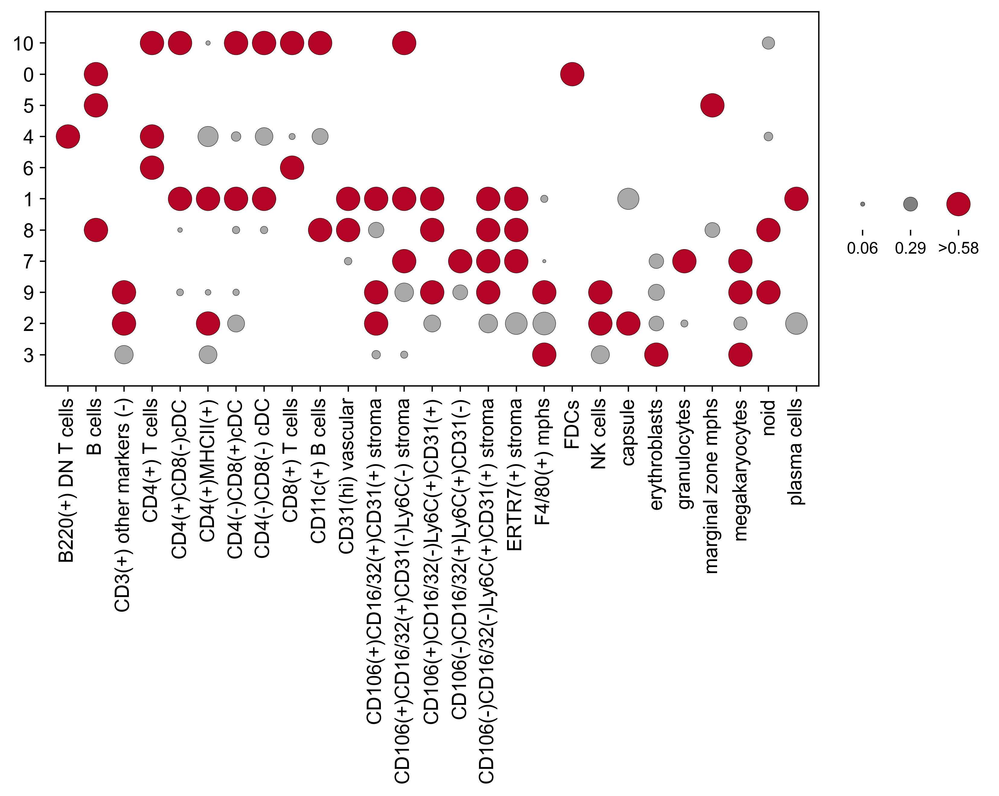

In [14]:
cc.gr.enrichment(adata, group_key='cell_type', label_key='spatial_cluster')
cc.pl.enrichment(adata, group_key='cell_type', label_key='spatial_cluster', color_threshold=0.58, size_threshold=0.58)

# Proximity analysis

The next step is to describe the relative arrangement of spatial clusters in the samples and observe whether the relative proximity between spatial clusters changes between the healthy and disease condition.
We extract the condition labels from the sample labels.

In [15]:
adata.obs['condition'] = adata.obs['sample'].str.split('-').str[0].astype('category')

We compute select the samples associated with the healthy condition and compute the neighborhood enrichment between the spatial clusters.

/mnt/ndata/varrone/curnagl_work/Packages/cellcharter-scverse/src/cellcharter/gr/_nhood.py:215: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{cluster_key}_nhood_enrichment"] = result
/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


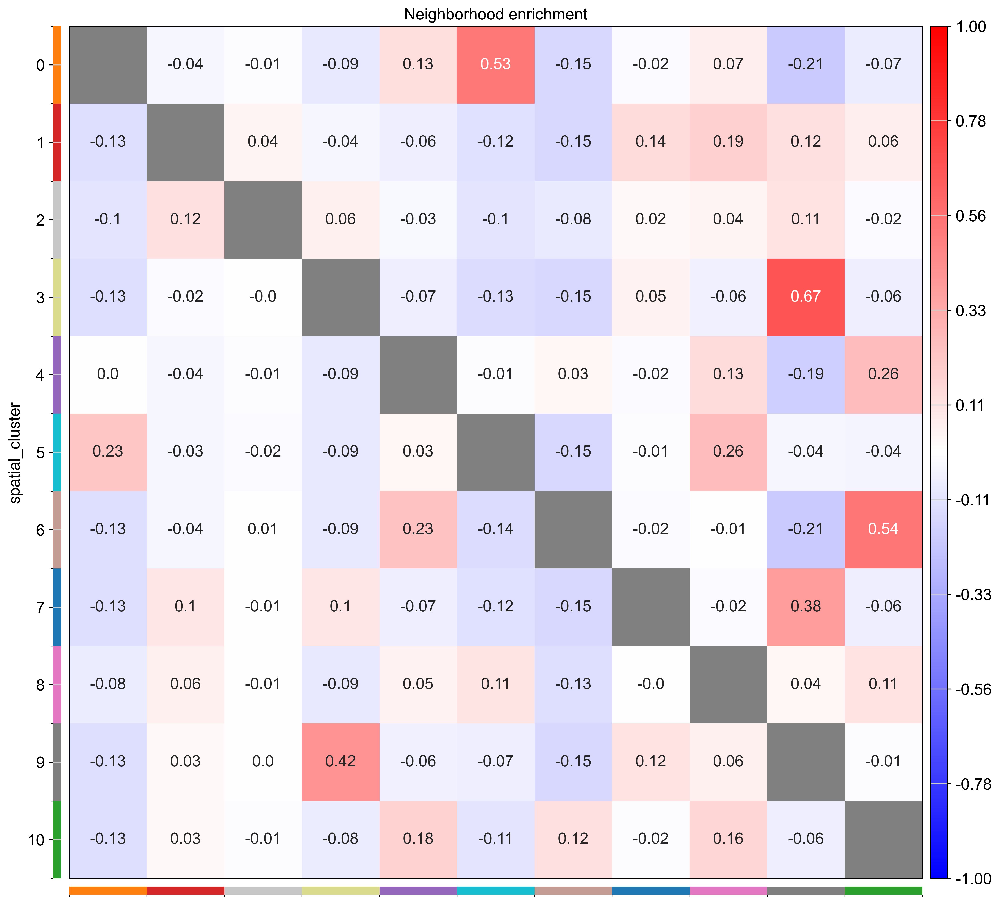

In [16]:
adata_balbc = adata[adata.obs['condition'] == 'BALBc']
cc.gr.nhood_enrichment(
    adata_balbc,
    cluster_key='spatial_cluster',
)

cc.pl.nhood_enrichment(
    adata_balbc,
    cluster_key='spatial_cluster',
    annotate=True,
    vmin=-1,
    vmax=1,
)

We repeat the analysis for the lupus condition.

/mnt/ndata/varrone/curnagl_work/Packages/cellcharter-scverse/src/cellcharter/gr/_nhood.py:215: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{cluster_key}_nhood_enrichment"] = result
/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


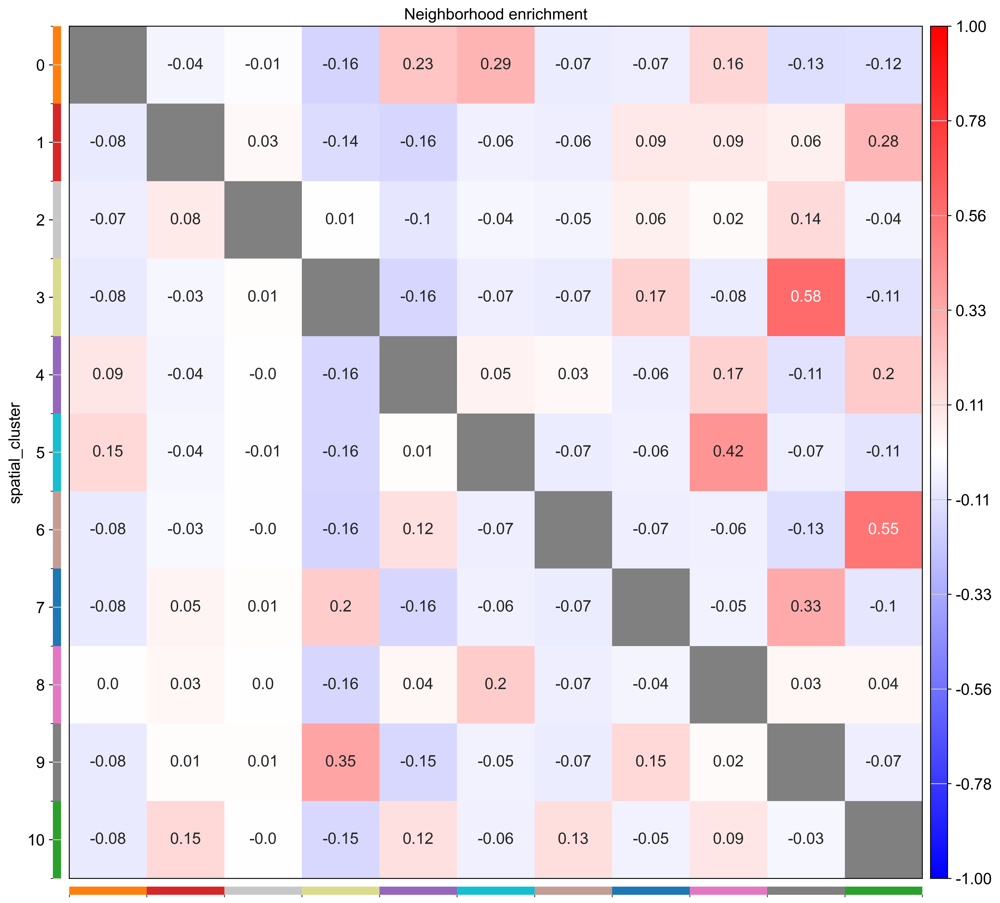

In [17]:
adata_mrl = adata[adata.obs['condition'] == 'MRL']
cc.gr.nhood_enrichment(
    adata_mrl,
    cluster_key='spatial_cluster',
)

cc.pl.nhood_enrichment(
    adata_mrl,
    cluster_key='spatial_cluster',
    annotate=True,
    vmin=-1,
    vmax=1,
    
)

While it would be possible to compare the differences in neighborhood enrichment by placing one plot next to the other, it is more convenient to use a single plot that shows the difference between the two conditions (i.e. differential neighborhood enrichment).

This is what `diff_nhood_enrichment` does. Optionally, we also decided to compute pvalues for each pair of clusters and set a threshold for significance. This increases the computational time of the function because it requires performing permutations to compute the pvalues, in this case `n_perms=100` permutations.

Luckily our implementation of an analytical version of the non-differential neighborhood enrichment that we just ran is very fast, otherwise we would have to run permutations of permutations. `diff_nhood_enrichment` also leverages multiprocessing, with the number of cores used being set by the `n_jobs` parameter.

In [18]:
cc.gr.diff_nhood_enrichment(
    adata,
    cluster_key='spatial_cluster',
    condition_key='condition',
    library_key='sample',
    pvalues=True,
    n_jobs=15,
    n_perms=100
)

  0%|          | 0/100 [00:00<?, ?it/s]

/home/varrone/miniconda3/envs/cellcharter-dev/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


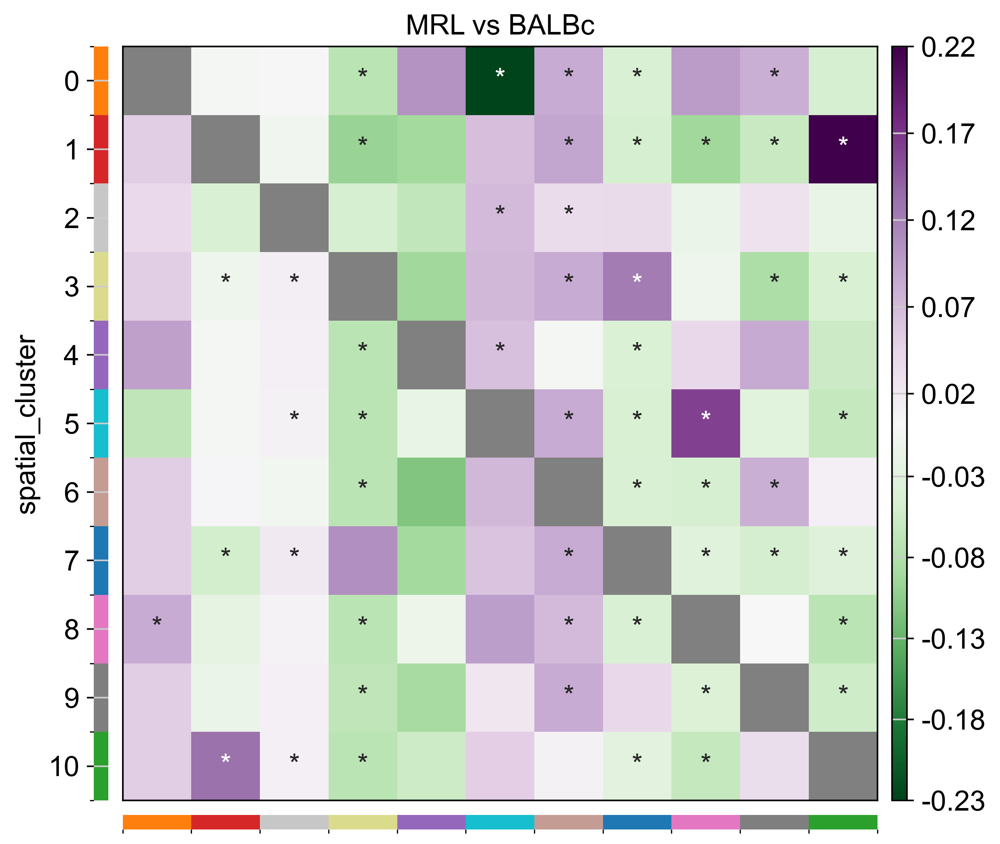

In [19]:
cc.pl.diff_nhood_enrichment(
    adata,
    cluster_key='spatial_cluster',
    condition_key='condition',
    condition_groups=['MRL', 'BALBc'],
    annotate=True,
    figsize=(7,7),
    significance=0.05
)

Similarly as in the paper, we can see that the B-follicles (C0 in orange) lose de adjacency with marginal zones (C5 in light blue) in the lupus spleen.

# Shape characterization

Another way to characterize changes in the spatial architecture of tissue samples is by measuring changes in shape of spatial clusters that are in common between the two conditions.

Since a spatial cluster may be repeated in multiple areas of the same sample, we need to find individual local clusters by computing the connected components of the spatial network.

In [20]:
cc.gr.connected_components(adata, cluster_key='spatial_cluster')

Then, we compute the boundaries around each local cluster.

In [21]:
cc.tl.boundaries(adata, min_hole_area_ratio=0.1)

In CellCharter we implemented four metrics described in the paper: linearity, curl, elongation and purity. In this example we are going to compare only the first two.

In [22]:
cc.tl.linearity(adata)
cc.tl.curl(adata)

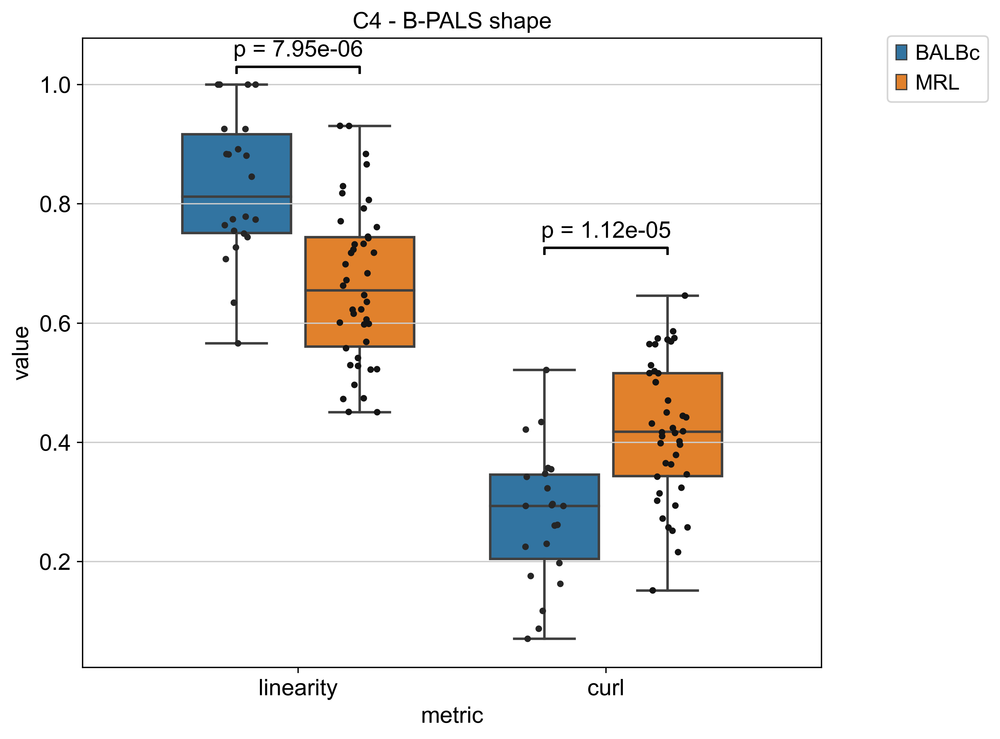

In [23]:
cc.pl.plot_shape_metrics(
    adata, 
    condition_key='condition', 
    condition_groups=['BALBc', 'MRL'],
    cluster_key='spatial_cluster', 
    cluster_id=[4], 
    title='C4 - B-PALS shape'
)

As we can see, the spatial cluster that is located between the B-follicles and the PALS tends to become less organized. This is reflected in a decrease of the linear shapes that characterized it, but more importantly in an increase in curl.